<a href="https://colab.research.google.com/github/guebin/DL2024/blob/main/posts/07wk-1-2.ipynb"><img src="https://colab.research.google.com/assets/colab-badge.svg" style="text-align: left"></a>

# 1. 강의영상 

{{<video https://youtu.be/playlist?list=PLQqh36zP38-wCMWh9t92iWHuMtzrdA3Gv&si=F85VH6sGFIIEmmL_ >}}

# 2. Imports

In [2]:
import torch 
import torchvision
import fastai.vision.all
import matplotlib.pyplot as plt
import requests

# 3. XAI란?

<https://brunch.co.kr/@hvnpoet/140>

# 4. CAM의 구현을 위한 예비학습 (Class Activation Map)

## A. DLS : data loaders

In [3]:
path = fastai.data.external.untar_data(fastai.data.external.URLs.PETS)
#path.ls()
(path/'images').ls()

(#7393) [Path('/home/myuser/.fastai/data/oxford-iiit-pet/images/german_shorthaired_163.jpg'),Path('/home/myuser/.fastai/data/oxford-iiit-pet/images/pomeranian_141.jpg'),Path('/home/myuser/.fastai/data/oxford-iiit-pet/images/great_pyrenees_43.jpg'),Path('/home/myuser/.fastai/data/oxford-iiit-pet/images/basset_hound_137.jpg'),Path('/home/myuser/.fastai/data/oxford-iiit-pet/images/japanese_chin_24.jpg'),Path('/home/myuser/.fastai/data/oxford-iiit-pet/images/english_cocker_spaniel_36.jpg'),Path('/home/myuser/.fastai/data/oxford-iiit-pet/images/samoyed_38.jpg'),Path('/home/myuser/.fastai/data/oxford-iiit-pet/images/keeshond_197.jpg'),Path('/home/myuser/.fastai/data/oxford-iiit-pet/images/beagle_179.jpg'),Path('/home/myuser/.fastai/data/oxford-iiit-pet/images/yorkshire_terrier_8.jpg')...]

라벨링이 대문자로 되어 있으면 고양이, 소문자로 되어 있으면 강아지

jpg 가 아닌 제대로되지 않은 mat 타입이 몇개 있다. 이를 jpg 타입만 추려서 사용하고 싶다.

In [ ]:
# mat 확장자의 이미지 (추려내야함)
(path/'images').ls()[214],(path/'images').ls()[448],(path/'images').ls()[2976]

In [ ]:
# bad_fnames = [l for l in (path/'images').ls() if str(l).split('.')[-1] != 'jpg']
# bad_fnames

In [ ]:
# fnames_ = [l for l in (path/'images').ls() if str(l).split('.')[-1] == 'jpg']
# fnames_

In [5]:
fnames = fastai.data.transforms.get_image_files(path/'images')
#fnames = [l for l in (path/'images').ls() if str(l).split('.')[-1] == 'jpg']   # 결과는 똑같음

In [ ]:
fnames  # 7393개에서 bad_fnames 3개를 뺀 총 7390개의 데이터셋이 준비됨.

In [ ]:
# fnames_ == fnames

In [4]:
def label_func(fname):
    if fname[0].isupper():
        return 'cat'
    else:
        return 'dog'

dls 방법1

In [6]:
dls = fastai.vision.data.ImageDataLoaders.from_name_func(
    path=path/'images',
    fnames = fnames,
    label_func = label_func,
    item_tfms = fastai.vision.augment.Resize(512),
    bs = 32
)

dls 방법2

In [ ]:
dls = fastai.vision.data.ImageDataLoaders.from_name_func(
    path = path/'images',
    fnames = [l for l in (path/'images').ls() if str(l).split('.')[-1] == 'jpg'],
    label_func = label_func,
    item_tfms = fastai.vision.augment.Resize(512),  # 이미지 크기가 각각 달라서, 통일하기 위한 과정
    bs = 32 # batch_size = 32 
)

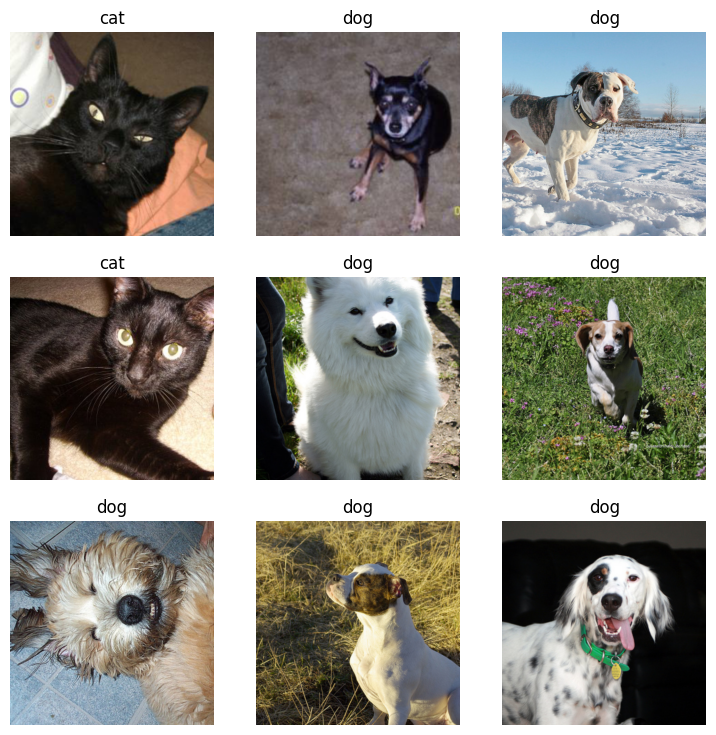

In [7]:
dls.show_batch()

In [8]:
dls.one_batch()

(TensorImage([[[[0.6706, 0.6667, 0.6706,  ..., 0.4431, 0.4392, 0.4275],
                [0.6784, 0.6745, 0.6745,  ..., 0.4549, 0.4471, 0.4353],
                [0.6824, 0.6784, 0.6745,  ..., 0.4471, 0.4353, 0.4275],
                ...,
                [0.4196, 0.4235, 0.4275,  ..., 0.4667, 0.4667, 0.4667],
                [0.4196, 0.4314, 0.4353,  ..., 0.4392, 0.4471, 0.4627],
                [0.4157, 0.4353, 0.4431,  ..., 0.4078, 0.4235, 0.4549]],
 
               [[0.5569, 0.5529, 0.5569,  ..., 0.4314, 0.4235, 0.4196],
                [0.5647, 0.5608, 0.5608,  ..., 0.4471, 0.4353, 0.4275],
                [0.5686, 0.5647, 0.5647,  ..., 0.4431, 0.4314, 0.4235],
                ...,
                [0.4000, 0.4118, 0.4196,  ..., 0.4314, 0.4314, 0.4314],
                [0.4039, 0.4235, 0.4314,  ..., 0.4039, 0.4078, 0.4235],
                [0.4078, 0.4353, 0.4431,  ..., 0.3686, 0.3843, 0.4157]],
 
               [[0.4000, 0.3922, 0.3922,  ..., 0.4392, 0.4392, 0.4314],
                

In [9]:
len(dls.one_batch())

2

In [10]:
dls.one_batch()[0] , dls.one_batch()[0].shape

(TensorImage([[[[0.0588, 0.0824, 0.1098,  ..., 0.3059, 0.2941, 0.2863],
                [0.0549, 0.0745, 0.1059,  ..., 0.3059, 0.2941, 0.2863],
                [0.0471, 0.0667, 0.0980,  ..., 0.3059, 0.2941, 0.2863],
                ...,
                [0.2784, 0.2549, 0.2235,  ..., 0.3608, 0.3098, 0.2706],
                [0.2745, 0.2549, 0.2275,  ..., 0.2941, 0.3020, 0.3098],
                [0.2745, 0.2549, 0.2314,  ..., 0.2471, 0.2980, 0.3373]],
 
               [[0.0824, 0.1059, 0.1333,  ..., 0.4941, 0.4980, 0.4980],
                [0.0784, 0.0980, 0.1255,  ..., 0.4941, 0.4980, 0.4980],
                [0.0706, 0.0902, 0.1176,  ..., 0.4941, 0.4980, 0.4980],
                ...,
                [0.3098, 0.2824, 0.2471,  ..., 0.3451, 0.3020, 0.2706],
                [0.3059, 0.2824, 0.2510,  ..., 0.2784, 0.2941, 0.3098],
                [0.3059, 0.2824, 0.2510,  ..., 0.2314, 0.2902, 0.3373]],
 
               [[0.0667, 0.0902, 0.1176,  ..., 0.7373, 0.7333, 0.7333],
                

In [11]:
dls.one_batch()[1] , dls.one_batch()[1].shape # batch size=32

(TensorCategory([1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0,
                 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1], device='cuda:0'),
 torch.Size([32]))

## B. 이미지 자료 불러오기

`-` 원래 우리가 아는 방법: path를 의미하는 string $\to$ torch.tensor 

type: <class 'torch.Tensor'>
shape: torch.Size([3, 333, 500])
dtype: torch.uint8


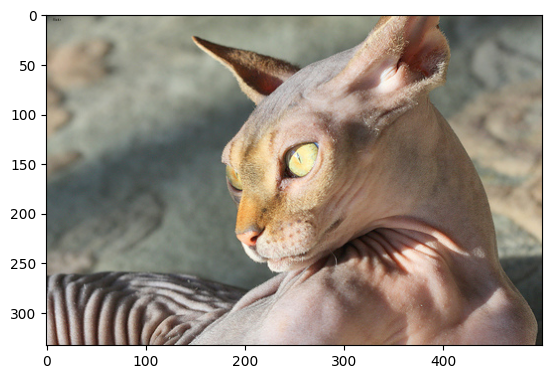

In [12]:
# x = torchvision.io.read_image('/home/myuser/.fastai/data/oxford-iiit-pet/images/Sphynx_14.jpg')
x = torchvision.io.read_image(path/'images/Sphynx_14.jpg')
print(f"type: {type(x)}")
print(f"shape: {x.shape}")
print(f"dtype: {x.dtype}")
plt.imshow(torch.einsum('ijk->jki',x))

`-` fastai를 이용하는 방법: path를 의미하는 string $\to$ PILImage $\to$ fastai.torch_core.TensorImage $\to$ torch.tensor

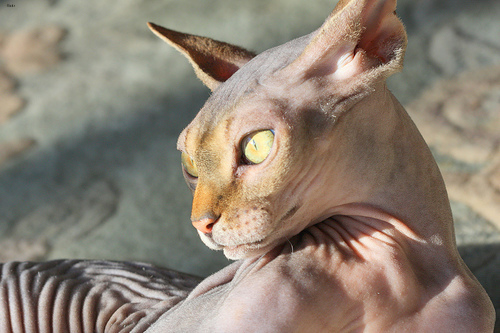

In [13]:
x_pil = fastai.vision.core.PILImage.create(path/'images/Sphynx_14.jpg')
x_pil

In [14]:
dls.test_dl([x_pil])

In [ ]:
iter(dls.test_dl([x_pil]))

In [15]:
next(iter(dls.test_dl([x_pil]))) 

(TensorImage([[[[0.6706, 0.6667, 0.6627,  ..., 0.3294, 0.3294, 0.3294],
                [0.6706, 0.6667, 0.6627,  ..., 0.3255, 0.3255, 0.3255],
                [0.6706, 0.6667, 0.6627,  ..., 0.3216, 0.3216, 0.3216],
                ...,
                [0.3333, 0.4353, 0.5569,  ..., 0.6157, 0.6078, 0.6000],
                [0.3098, 0.4039, 0.5216,  ..., 0.6157, 0.6039, 0.5961],
                [0.2941, 0.3804, 0.4941,  ..., 0.6157, 0.6039, 0.5922]],
 
               [[0.6784, 0.6745, 0.6706,  ..., 0.3373, 0.3412, 0.3451],
                [0.6784, 0.6745, 0.6706,  ..., 0.3373, 0.3412, 0.3451],
                [0.6824, 0.6784, 0.6706,  ..., 0.3412, 0.3451, 0.3451],
                ...,
                [0.2196, 0.3373, 0.4902,  ..., 0.4471, 0.4588, 0.4667],
                [0.1961, 0.3098, 0.4627,  ..., 0.4627, 0.4706, 0.4706],
                [0.1765, 0.2902, 0.4431,  ..., 0.4745, 0.4745, 0.4706]],
 
               [[0.6235, 0.6196, 0.6157,  ..., 0.3176, 0.3020, 0.2902],
                

In [16]:
next(iter(dls.test_dl([x_pil])))[0].shape

torch.Size([1, 3, 512, 512])

In [ ]:
len(next(iter(dls.test_dl([x_pil]))))

type: <class 'fastai.torch_core.TensorImage'>
shape: torch.Size([1, 3, 512, 512])
dtype: torch.float32


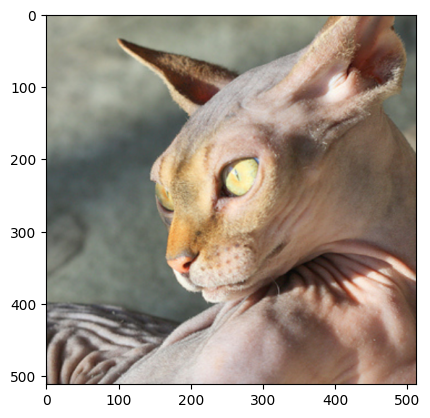

In [17]:
x_pil = fastai.vision.core.PILImage.create(path/'images/Sphynx_14.jpg')
x = next(iter(dls.test_dl([x_pil])))[0]
print(f"type: {type(x)}")
print(f"shape: {x.shape}")
print(f"dtype: {x.dtype}")
plt.imshow(torch.einsum('ocij->ijc',x.to("cpu")))
# print('---')
# x = torch.tensor(x)
# print(f"type: {type(x)}")
# print(f"shape: {x.shape}")
# print(f"dtype: {x.dtype}")

In [ ]:
fastai.vision.core.PILImage.create?

In [ ]:
requests.get('https://github.com/guebin/DL2024/blob/main/imgs/01wk-hani1.jpeg?raw=true').content

In [25]:
x_pil = fastai.vision.core.PILImage.create(requests.get('https://github.com/guebin/DL2024/blob/main/imgs/01wk-hani1.jpeg?raw=true').content)
x = next(iter(dls.test_dl([x_pil])))[0]
# x = fastai.torch_core.TensorImage(x_pil)

print(f"type: {type(x)}")
print(f"shape: {x.shape}")
print(f"dtype: {x.dtype}")

type: <class 'fastai.torch_core.TensorImage'>
shape: torch.Size([1, 3, 512, 512])
dtype: torch.float32


`-` 참고로 아래와 같이 이미지변환할 수도 있음.  **fastai.torch_core.TensorImage**

In [21]:
x_pil = fastai.vision.core.PILImage.create(path/'images/Sphynx_14.jpg')
#x = next(iter(dls.test_dl([x_pil])))[0]
x = fastai.torch_core.TensorImage(x_pil)
print(f"type: {type(x)}")
print(f"shape: {x.shape}")  # default shape
print(f"dtype: {x.dtype}")

type: <class 'fastai.torch_core.TensorImage'>
shape: torch.Size([333, 500, 3])
dtype: torch.uint8


## C. 이미지 자료 시각화 

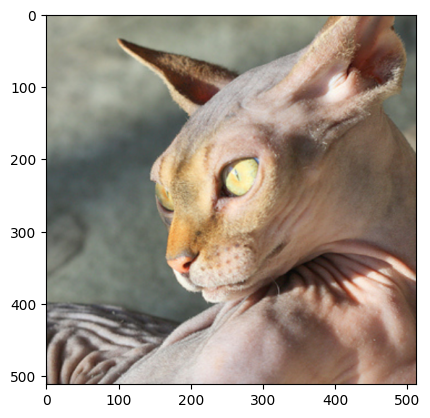

In [26]:
x_pil = fastai.vision.core.PILImage.create(path/'images/Sphynx_14.jpg')
x = next(iter(dls.test_dl([x_pil])))[0] # lrnr를 학습이후에는 여기에 저장되는 x값이 조금 달라지게됨, # obserbation 차원이 없음
x_dec = dls.decode([x])                 # obserbation 차원이 존재
plt.imshow(torch.einsum('ocij -> ijc', x_dec))

In [27]:
len(x_dec) , len(x), x_dec[0].shape , x[0].shape

(1, 1, torch.Size([1, 3, 512, 512]), torch.Size([3, 512, 512]))

In [ ]:
x.device

## D. AP layer 

In [28]:
ap = torch.nn.AdaptiveAvgPool2d(output_size=1)
ap

AdaptiveAvgPool2d(output_size=1)

In [29]:
X = torch.arange(1*3*4*4).reshape(1,3,4,4)*1.0 
X

tensor([[[[ 0.,  1.,  2.,  3.],
          [ 4.,  5.,  6.,  7.],
          [ 8.,  9., 10., 11.],
          [12., 13., 14., 15.]],

         [[16., 17., 18., 19.],
          [20., 21., 22., 23.],
          [24., 25., 26., 27.],
          [28., 29., 30., 31.]],

         [[32., 33., 34., 35.],
          [36., 37., 38., 39.],
          [40., 41., 42., 43.],
          [44., 45., 46., 47.]]]])

In [30]:
X[:,0,:,:]  # r

tensor([[[ 0.,  1.,  2.,  3.],
         [ 4.,  5.,  6.,  7.],
         [ 8.,  9., 10., 11.],
         [12., 13., 14., 15.]]])

In [31]:
ap(X) # 채널별로 평균을 구해줌. 

tensor([[[[ 7.5000]],

         [[23.5000]],

         [[39.5000]]]])

In [ ]:
# ap2 = torch.nn.AdaptiveAvgPool2d(output_size=2)
# ap2(X) # 채널별로 평균(2x2)을 구해줌. 

In [32]:
ap(X).shape

torch.Size([1, 3, 1, 1])

In [34]:
X[0] , X[0].shape

(tensor([[[ 0.,  1.,  2.,  3.],
          [ 4.,  5.,  6.,  7.],
          [ 8.,  9., 10., 11.],
          [12., 13., 14., 15.]],
 
         [[16., 17., 18., 19.],
          [20., 21., 22., 23.],
          [24., 25., 26., 27.],
          [28., 29., 30., 31.]],
 
         [[32., 33., 34., 35.],
          [36., 37., 38., 39.],
          [40., 41., 42., 43.],
          [44., 45., 46., 47.]]]),
 torch.Size([3, 4, 4]))

In [35]:
r,g,b = X[0]    # UNPACKING

In [36]:
r.shape, g.shape, b.shape

(torch.Size([4, 4]), torch.Size([4, 4]), torch.Size([4, 4]))

In [182]:
r.mean(), g.mean(), b.mean()

(tensor(7.5000), tensor(23.5000), tensor(39.5000))

In [38]:
ap(r), ap(g), ap(b) 

(tensor([[7.5000]]), tensor([[23.5000]]), tensor([[39.5000]]))

In [39]:
ap(r) == torch.tensor([r.mean()]).reshape(1,1)

tensor([[True]])

## E. AP, Linear의 교환

`-` 신기한 거 보여줄까요??

In [ ]:
ap(r)*0.1 + ap(g)*0.2 + ap(b)*0.3

In [183]:
(r*0.1 + g*0.2 + b*0.3).shape

torch.Size([4, 4])

In [181]:
ap(r*0.1 + g*0.2 + b*0.3)

tensor([[17.3000]])

- 별로 안 신기함.. 당연한것 아니야?  (선형변환)

`-` `torch.nn.Linear()` 와 `torch.nn.Flatten()` 를 이용한 구현 

In [40]:
flatten = torch.nn.Flatten()
l = torch.nn.Linear(3,1,bias=False)

In [41]:
X.shape ,ap(X).shape , flatten(ap(X)).shape

(torch.Size([1, 3, 4, 4]), torch.Size([1, 3, 1, 1]), torch.Size([1, 3]))

In [42]:
l.weight.data , l.bias , l.weight.data.shape 

(tensor([[-0.2034, -0.2779,  0.5549]]), None, torch.Size([1, 3]))

In [51]:
# ap(r)*0.1 + ap(g)*0.2 + ap(b)*0.3
l.weight.data = torch.tensor([[0.1, 0.2, 0.3]])
l(flatten(ap(X)))   #  ap(1311) -> flat(13) -> linear(11)


tensor([[[[12.8000, 13.4000, 14.0000, 14.6000],
          [15.2000, 15.8000, 16.4000, 17.0000],
          [17.6000, 18.2000, 18.8000, 19.4000],
          [20.0000, 20.6000, 21.2000, 21.8000]]]])

In [52]:
torch.einsum('ocij,kc->okij',X,l.weight.data) #1344 13 --> 1144

tensor([[[[12.8000, 13.4000, 14.0000, 14.6000],
          [15.2000, 15.8000, 16.4000, 17.0000],
          [17.6000, 18.2000, 18.8000, 19.4000],
          [20.0000, 20.6000, 21.2000, 21.8000]]]])

In [60]:
r,g,b=X[0]
r*l.weight.data[0][0] + g*l.weight.data[0][1] + b*l.weight.data[0][2]

tensor([[12.8000, 13.4000, 14.0000, 14.6000],
        [15.2000, 15.8000, 16.4000, 17.0000],
        [17.6000, 18.2000, 18.8000, 19.4000],
        [20.0000, 20.6000, 21.2000, 21.8000]])

In [66]:
torch.einsum('ocij,kc->okij',X,l.weight.data)  == r*l.weight.data[0][0] + g*l.weight.data[0][1] + b*l.weight.data[0][2] # 1 1 4 4

tensor([[[[True, True, True, True],
          [True, True, True, True],
          [True, True, True, True],
          [True, True, True, True]]]])

In [65]:
# r,g,b 채널별로 선형결합해주고 ap를 취한다.
ap(r*l.weight.data[0][0] + g*l.weight.data[0][1] + b*l.weight.data[0][2])

tensor([[17.3000]])

In [62]:
torch.einsum('ocij,kc -> okij',X,l.weight.data).shape    # 1344,'1'3 -> 1'1'44 

torch.Size([1, 1, 4, 4])

In [63]:
ap(torch.einsum('ocij,kc -> okij',X,l.weight.data)).shape   # ap( 1344,'1'3 -> 1'1'44 ) --> 1111

torch.Size([1, 1, 1, 1])

In [64]:
flatten(ap(torch.einsum('ocij,kc -> okij',X,l.weight.data))).shape  # einsum(1344,'1'3) --> 1144 ->1111 ->11

torch.Size([1, 1])

In [67]:
#ap(r*0.1 + g*0.2 + b*0.3) ## 각각의 픽셀에 l을 취하고 그 결과에 ap를 취해야함 
flatten(ap(torch.einsum('ocij,kc -> okij',X,l.weight.data)))    # ap( 1344,'1'3 -> 1'1'44 ) --> 1111

tensor([[17.3000]])

`-` 정리

In [75]:
# 계산3: x를 linear, flatten ap 순서로 적용
print(f"{X.shape} -- X")
print(f"{torch.einsum('ocij,kc -> okij',X,l.weight.data).shape} -- l(X)")
print(f"{flatten(torch.einsum('ocij,kc -> okij',X,l.weight.data)).shape} -- flatten(l(X))")
print(f"{ap(flatten(torch.einsum('ocij,kc -> okij',X,l.weight.data))).shape} -- ap(flatten(l(X)))")
print(f"{ap(flatten(torch.einsum('ocij,kc -> okij',X,l.weight.data)))} -- ap(flatten(l(X)))")


torch.Size([1, 3, 4, 4]) -- X
torch.Size([1, 1, 4, 4]) -- l(X)
torch.Size([1, 16]) -- flatten(l(X))
torch.Size([1, 1]) -- ap(flatten(l(X)))
tensor([[17.3000]]) -- ap(flatten(l(X)))


In [82]:
# 계산4: x를 ap, linear, flatten 순서로 적용
print(f"{X.shape} -- X")                                        # 1344
print(f"{ap(X).shape} -- ap(X)")                                # 1311
print(f"{torch.einsum('ocij,kc ->okij',ap(X),l.weight.data).shape} -- l(ap(X))")           # 1311 13 --> 1111
print(f"{flatten(torch.einsum('ocij,kc ->okij',ap(X),l.weight.data)).shape} -- flatten(l(ap(X)))")           # 11
print(f"{flatten(torch.einsum('ocij,kc ->okij',ap(X),l.weight.data))} -- flatten(l(ap(X)))")           # 11

torch.Size([1, 3, 4, 4]) -- X
torch.Size([1, 3, 1, 1]) -- ap(X)
torch.Size([1, 1, 1, 1]) -- l(ap(X))
torch.Size([1, 1]) -- flatten(l(ap(X)))
tensor([[17.3000]]) -- flatten(l(ap(X)))


In [77]:
# 계산1: x를 ap, flatten, linear 순서로 적용
print(f"{X.shape} -- X")                                        # 1344
print(f"{ap(X).shape} -- ap(X)")                                # 1311
print(f"{flatten(ap(X)).shape} -- flatten(ap(X))")              # 13
print(f"{l(flatten(ap(X))).shape} -- l(flatten(ap(X)))")        # 11
print(f"{l(flatten(ap(X)))} -- l(flatten(ap(X)))")        # 11

torch.Size([1, 3, 4, 4]) -- X
torch.Size([1, 3, 1, 1]) -- ap(X)
torch.Size([1, 3]) -- flatten(ap(X))
torch.Size([1, 1]) -- l(flatten(ap(X)))
tensor([[17.3000]], grad_fn=<MmBackward0>) -- l(flatten(ap(X)))


In [76]:
# 계산2: x를 linear, ap, flatten 순서로 적용
print(f"{X.shape} -- X")
print(f"{torch.einsum('ocij,kc -> okij',X,l.weight.data).shape} -- l(X)")
print(f"{ap(torch.einsum('ocij,kc -> okij',X,l.weight.data)).shape} -- ap(l(X))")
print(f"{flatten(ap(torch.einsum('ocij,kc -> okij',X,l.weight.data))).shape} -- flatten(ap(l(X)))")
print(f"{flatten(ap(torch.einsum('ocij,kc -> okij',X,l.weight.data)))} -- flatten(ap(l(X)))")

torch.Size([1, 3, 4, 4]) -- X
torch.Size([1, 1, 4, 4]) -- l(X)
torch.Size([1, 1, 1, 1]) -- ap(l(X))
torch.Size([1, 1]) -- flatten(ap(l(X)))
tensor([[17.3000]]) -- flatten(ap(l(X)))


$$\underset{(n,3,4,4)}{\boldsymbol X} \overset{ap}{\to} \underset{(n,3,1,1)}{{\boldsymbol \sharp}}\overset{flatten}{\to} \underset{(n,3)}{{\boldsymbol \sharp}}\overset{linear}{\to} \underset{(n,1)}{\hat{\boldsymbol y}} = [[17.3],...]$$

$$\underset{(n,3,4,4)}{\boldsymbol X} \overset{linear}{\to} \underset{(n,1,4,4)}{{\boldsymbol \sharp}}\overset{ap}{\to} \underset{(n,1,1,1)}{{\boldsymbol \sharp}}\overset{flatten}{\to} \underset{(n,1)}{\hat{\boldsymbol y}} = [[17.3],...]$$

# 5. CAM[@zhou2016learning]의 구현

ref: <https://arxiv.org/abs/1512.04150>

`-` 이 강의노트는 위의 논문의 내용을 재구성하였음. 

- 논문의 수식을 이해해서 코드로 재구성하는 능력이 새로운 방법을 빠르게 습득할 수 있도록 해줌.
- 학기 끝나고 "논문->코드"로 만드는 과정을 연습하면 대학원등에서 공부할때 도움이 될 것 같음. 

## A. 1단계 -- 이미지분류 잘하는 네트워크 선택 후 학습
- net, 손실함수, 

`-` 이전 06wk-1 에서는 lrnr 을 다음과 같이 선언함. lrnr = fastai.learner.Learner(...)
- lrnr = fastai.learner.Learner(  
    dls=dls,  
    model=torchvision.models.resnet18(),  
    loss_func=loss_fn,  
    metrics=[fastai.metrics.accuracy])

In [ ]:
fastai.vision.learner.vision_learner?

In [83]:
# 손실함수를 정의하지 않더라도, vision 의 경우는 알아서 cross entropy로 지정해준다. 생략가능! 
# optimizer, lr ,metric또한 생략 가능
lrnr = fastai.vision.learner.vision_learner(
    dls = dls,
    arch = fastai.vision.models.resnet34, 
    metrics = [fastai.metrics.accuracy]
)    

In [ ]:
# 손실함수를 정의하지 않더라도, vision 의 경우는 알아서 cross entropy로 지정해준다. 생략가능! 
lrnr.loss_func

In [ ]:
lrnr.arch()

In [84]:
lrnr.model[0]

Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Con

In [98]:
lrnr.model[1]

Sequential(
  (0): AdaptiveConcatPool2d(
    (ap): AdaptiveAvgPool2d(output_size=1)
    (mp): AdaptiveMaxPool2d(output_size=1)
  )
  (1): fastai.layers.Flatten(full=False)
  (2): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (3): Dropout(p=0.25, inplace=False)
  (4): Linear(in_features=1024, out_features=512, bias=False)
  (5): ReLU(inplace=True)
  (6): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (7): Dropout(p=0.5, inplace=False)
  (8): Linear(in_features=512, out_features=2, bias=False)
)

`-` fine_tune 과 fit의 차이
- fine_tune : 네트워크로 삼은 파라미터를 처음부터 다시 학습하는게 아니라, 끝부분 가중치만 학습
- fit은 주어진 모델을 처음부터 끝까지 완전하게 훈련시키는 과정입니다. 이 경우, 모든 가중치가 무작위로 초기화되며, 모델이 데이터를 학습하면서 가중치를 조정합니다.


In [ ]:
lrnr.fine_tune(1)   # 말단만 재학습

## B. 2단계-- 네트워크의 끝 부분 수정하고 재학습

`-` 일반적으로 CNN계열은 2D-part와 1D-part로 구분되어있음.


In [87]:
net1 = lrnr.model[0] # 2d-part : 학습에 핵심적인 요소
net2 = lrnr.model[1] # 1d-part : 정리하는 요소, 이 부분만 fine_tune으로 바꿔서, net1은 유지한채로 net2 wetight만 재학습한다는 의미

In [88]:
net1

Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Con

In [93]:
net2 # (8): in_features=512, out_features=2,

Sequential(
  (0): AdaptiveConcatPool2d(
    (ap): AdaptiveAvgPool2d(output_size=1)
    (mp): AdaptiveMaxPool2d(output_size=1)
  )
  (1): fastai.layers.Flatten(full=False)
  (2): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (3): Dropout(p=0.25, inplace=False)
  (4): Linear(in_features=1024, out_features=512, bias=False)
  (5): ReLU(inplace=True)
  (6): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (7): Dropout(p=0.5, inplace=False)
  (8): Linear(in_features=512, out_features=2, bias=False)
)

In [96]:
# 하나의 배치를 테스트용으로 임시로 가져옴
_X, _y = dls.one_batch() 
_X.shape,_y.shape   # batch size : 32

(torch.Size([32, 3, 512, 512]), torch.Size([32]))

In [100]:
net1(_X.to("cpu")).shape

torch.Size([32, 512, 16, 16])

In [104]:
net2[0](net1(_X.to("cpu"))).shape   #   (0): AdaptiveConcatPool2d((ap): AdaptiveAvgPool2d(output_size=1)(mp): AdaptiveMaxPool2d(output_size=1))

torch.Size([32, 1024, 1, 1])

In [105]:
net2(net1(_X.to("cpu"))).shape

torch.Size([32, 2])

In [101]:
_X.device

device(type='cuda', index=0)

In [109]:
net1.to("cuda:0")
net2.to("cuda:0")
print(f"입력이미지:\t\t {_X.shape}")
print(f"net1통과직후:\t\t {net1(_X).shape}")
print(f"net2의AP까지통과직후:\t {net2[0](net1(_X)).shape}")
print(f"net2의Flatten까지통과직후:\t {net2[1](net2[0](net1(_X))).shape}")
print(f"net2끝까지통과:\t\t {net2(net1(_X)).shape}")
net1.to("cpu")
net2.to("cpu")

입력이미지:		 torch.Size([32, 3, 512, 512])
net1통과직후:		 torch.Size([32, 512, 16, 16])
net2의AP까지통과직후:	 torch.Size([32, 1024, 1, 1])
net2의Flatten까지통과직후:	 torch.Size([32, 1024])
net2끝까지통과:		 torch.Size([32, 2])


Sequential(
  (0): AdaptiveConcatPool2d(
    (ap): AdaptiveAvgPool2d(output_size=1)
    (mp): AdaptiveMaxPool2d(output_size=1)
  )
  (1): fastai.layers.Flatten(full=False)
  (2): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (3): Dropout(p=0.25, inplace=False)
  (4): Linear(in_features=1024, out_features=512, bias=False)
  (5): ReLU(inplace=True)
  (6): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (7): Dropout(p=0.5, inplace=False)
  (8): Linear(in_features=512, out_features=2, bias=False)
)

`-` net2를 아래와 같이 수정하자. (왜??)  4/6강 15분경
- 기존 
    - Sequential(
        (0): AdaptiveConcatPool2d(   
            (ap): AdaptiveAvgPool2d(output_size=1)   
            (mp): AdaptiveMaxPool2d(output_size=1)   
        )   
        (1): fastai.layers.Flatten(full=False)   
        (2): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)   
        (3): Dropout(p=0.25, inplace=False)   
        (4): Linear(in_features=1024, out_features=512, bias=False)   
        (5): ReLU(inplace=True)   
        (6): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)  
        (7): Dropout(p=0.5, inplace=False)  
        (8): Linear(in_features=512, out_features=2, bias=False)  
        )   

In [110]:
# ap -> flatten -> linear
net2 = torch.nn.Sequential(
    torch.nn.AdaptiveAvgPool2d(output_size=1), # [n, 512, 16, 16] --> [n, 512, 1, 1]
    torch.nn.Flatten(), # [n, 512, 1, 1] -->  [n, 512]
    torch.nn.Linear(512,2,bias=False) # [n,512] --> [n,2] 
)

In [111]:
net = torch.nn.Sequential(
    net1, # 원래 resnet34에 있던거..
    net2 # 내가 (CAM을 위해서) 마음대로 바꾼것.. 
)
net.to("cuda:0")

Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

In [ ]:
# # 손실함수를 정의하지 않더라도, vision 의 경우는 알아서 cross entropy로 지정해준다. 생략가능! 
# # optimizer, lr ,metric또한 생략 가능
# lrnr = fastai.vision.learner.vision_learner(
#     dls = dls,
#     arch = fastai.vision.models.resnet34, 
#     metrics = [fastai.metrics.accuracy]
# )    
# net1 = lrnr.model[0] # 2d-part : 학습에 핵심적인 요소
# net2 = lrnr.model[1] # 1d-part : 정리하는 요소, 이 부분만 fine_tune으로 바꿔서, net1은 유지한채로 net2 wetight만 재학습한다는 의미

In [112]:
lrnr2 = fastai.learner.Learner(
    dls = dls, 
    model = net,
    metrics = [fastai.metrics.accuracy] 
)    

In [ ]:
lrnr.loss_func, lrnr2.loss_func # loss_fn 은 따로 정의안했는데 알아서 잘 들어가 있음

In [113]:
lrnr2.fine_tune(1) # net2를 내마음대로 수정했고, 그것에 대한 패널티로 accuracy가 안좋아짐! 그렇지만 그런대로 쓸만함. 

epoch,train_loss,valid_loss,accuracy,time
0,0.102809,0.023896,0.994587,01:21


epoch,train_loss,valid_loss,accuracy,time
0,0.023148,0.008310,0.997970,01:21


## C. 3단계-- 수정된 net2에서 Linear와 AP의 순서를 바꿈 
`-` 기존 : ap -> flatten -> linear
- Sequential(   
  (0): AdaptiveConcatPool2d(   
    (ap): AdaptiveAvgPool2d(output_size=1)   
    (mp): AdaptiveMaxPool2d(output_size=1)   
  )   
  (1): fastai.layers.Flatten(full=False)   
  (2): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)   
  (3): Dropout(p=0.25, inplace=False)   
  (4): Linear(in_features=1024, out_features=512, bias=False)  
  (5): ReLU(inplace=True)  
  (6): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)  
  (7): Dropout(p=0.5, inplace=False)  
  (8): Linear(in_features=512, out_features=2, bias=False)  
  )  

`-` 1개의 observation을 고정

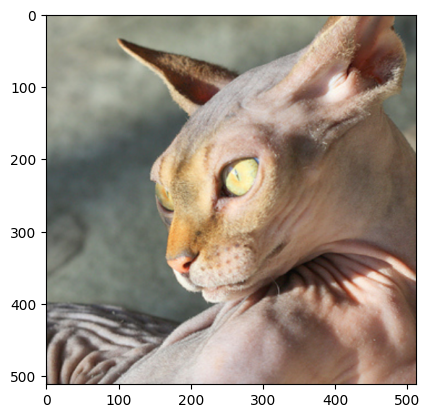

In [114]:
x_pil = fastai.vision.core.PILImage.create(path/'images/Sphynx_14.jpg')
x = next(iter(dls.test_dl([x_pil])))[0]
x_dec = dls.decode([x])[0]
plt.imshow(torch.einsum('ocij -> ijc', x_dec))

In [ ]:
x.shape

`-` 하나의 observation이 yhat까지 나오는 과정

net2 와 lrnr2.model[-1] 는 주소가 같다. 동일 객체라는 의미

In [ ]:
id(net2) == id(lrnr2.model[-1])

In [ ]:
lrnr2.model[-1] # net2 는 AP , Flatten , Linear 순서로 됨

In [ ]:
lrnr2.model[-1][0], lrnr2.model[-1][1], lrnr2.model[-1][2]

In [ ]:
(lrnr2.model[-1][2]).weight.data.shape

In [134]:
x.shape

torch.Size([1, 3, 512, 512])

In [140]:
# 계산방식1: 원래계산방식 : ap -> fc -> linear
ap = lrnr2.model[-1][0]
fl = lrnr2.model[-1][1]
l = lrnr2.model[-1][2]
print(f"{x.shape} -- x")
# step 1 : net1의 conv 를 통해 feature 추출
print(f"{net1(x).shape} -- net1(x)")
# step 2 : 추출된 feature 를 AdaptiveAvgPool2d 함 기본 3x512x512 사이즈의 이미지가 1x1 의 float타입의 수 한개로 압축됨. 
print(f"{ap(net1(x)).shape} -- ap(net1(x))")
# step 3 : fully connected layer
print(f"{fl(ap(net1(x))).shape} -- flatten(ap(net1(x)))")
# step 4 : 다시 선형결합. 출력결과는 softmax의 input으로 들어간다.
print(f"{l(fl(ap(net1(x)))).shape} -- l(flatten(ap(net1(x))))")
# l(fl(ap(net1(x))))
print(f"l(fl(ap(net1(x)))) : {l(fl(ap(net1(x)))).data}")
print(f"고양이일 가능성 : {l(fl(ap(net1(x))))[0][0].data}")
print(f"강아지일 가능성 : {l(fl(ap(net1(x))))[0][1].data}")

torch.Size([1, 3, 512, 512]) -- x
torch.Size([1, 512, 16, 16]) -- net1(x)
torch.Size([1, 512, 1, 1]) -- ap(net1(x))
torch.Size([1, 512]) -- flatten(ap(net1(x)))
torch.Size([1, 2]) -- l(flatten(ap(net1(x))))
l(fl(ap(net1(x)))) : TensorImage([[ 3.8664, -5.1304]], device='cuda:0')
고양이일 가능성 : TensorImage(3.8664, device='cuda:0')
강아지일 가능성 : TensorImage(-5.1304, device='cuda:0')


torch.Size([1, 16, 16])


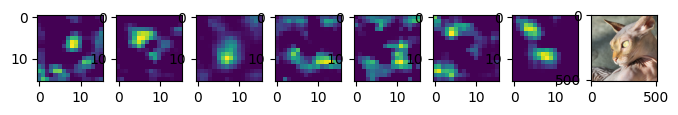

In [158]:
# net1의 출력
print((net1(x))[:,0,:,:].shape)
(net1(x))[:,0,:,:].data.to("cpu")

fig,ax = plt.subplots(1,8,figsize=(8,4))

# 이러한 16x16 feature에 대한 채널이 512개가 있다는 말.. 이건 인간에게 직관적이지 않다.
ax[0].imshow(torch.einsum('oij->ij',(net1(x))[:,0,:,:].data.to("cpu")))
ax[1].imshow(torch.einsum('oij->ij',(net1(x))[:,1,:,:].data.to("cpu")))
ax[2].imshow(torch.einsum('oij->ij',(net1(x))[:,2,:,:].data.to("cpu")))
ax[3].imshow(torch.einsum('oij->ij',(net1(x))[:,3,:,:].data.to("cpu")))
ax[4].imshow(torch.einsum('oij->ij',(net1(x))[:,4,:,:].data.to("cpu")))
ax[5].imshow(torch.einsum('oij->ij',(net1(x))[:,5,:,:].data.to("cpu")))
ax[6].imshow(torch.einsum('oij->ij',(net1(x))[:,6,:,:].data.to("cpu")))

ax[7].imshow(torch.einsum('ocij -> ijc', x_dec),cmap='magma')


In [139]:
print(f"{ap(net1(x))[0,0]} -- ap(net1(x))")

TensorImage([[0.4886]], device='cuda:0', grad_fn=<AliasBackward0>) -- ap(net1(x))


기존의 AP , Flatten , Linear 순서로 된 net2 를 **linear, Ap, Flatten 순서**로 바꿔보고싶다. 
- AP , Flatten , Linear 순서로 하나, linear, Ap, Flatten 순서로 하나 결과값은 똑같다. 그러니 순서는 바꿔도 결과에 아무 영향이 없으므로 바꿔도 된다.
- 그럼 왜 순서를 바꾸느냐? Linear 를 먼저했을때, 그떄의 이미지를 plt로 보면 인간이 직관적으로 이해할 수 있어서

**net2의 순서 바꾸기 전 전체 네트워크**
$$\underset{(1,3,512,512)}{\boldsymbol x} \overset{net_1}{\to} \left( \underset{(1,512,16,16)}{\tilde{\boldsymbol x}} \overset{ap}{\to} \underset{(1,512,1,1)}{{\boldsymbol \sharp}}\overset{flatten}{\to} \underset{(1,512)}{{\boldsymbol \sharp}}\overset{linear}{\to} \underset{(1,2)}{\hat{\boldsymbol y}}\right) = [[2.7846, -2.7945]]$$

In [116]:
net1(x).shape

torch.Size([1, 512, 16, 16])

In [159]:
l.weight.data , l.weight.data.shape # input 512, output 2

(tensor([[-0.0343,  0.0135,  0.0656,  ..., -0.0059,  0.0175, -0.0187],
         [ 0.0085,  0.0215, -0.0534,  ..., -0.0254, -0.0417,  0.0125]],
        device='cuda:0'),
 torch.Size([2, 512]))

In [198]:
# 기존의 AP , Flatten , Linear 순서로 된 net2 를 linear, Ap, Flatten 순서로 바꿔보고싶다. 
# 이미 fine_tune을 통해 net1에 대한 학습을 끝내서, 개와 고양이에 대한 feature는 기가막히게 잘 따는 상황

# 계산방식2: net2의 순서를 바꾼 계산 (ap,flatten,linear 에서 linear,flatten,ap로 바꿈) 어차피 결과는 똑같을거고, 기존 classification 성능에 악영향을 끼치지 않을거라는 판단. 결과는 같다.
# 그래도 결과는 똑같겠죠.
ap = lrnr2.model[-1][0]
fl = lrnr2.model[-1][1]
l = lrnr2.model[-1][2]
WHY = torch.einsum('ocij,kc -> okij', net1(x), l.weight.data)   # linear
print(f"{x.shape} -- x")
print(f"{net1(x).shape} -- net1(x)")
print("=======================================")
print(f"{WHY.shape} -- l(net1(x)):=WHY")                        # linear
print(f"{ap(WHY).shape} -- ap(l(net1(x)))=ap(WHY)")             # linear ap
print(f"{fl(ap(WHY)).shape} -- flatten(ap(l(net1(x)))))=flatten(ap(WHY))")  # linear ap flatten
fl(ap(torch.einsum('ocij,kc -> okij', net1(x), l.weight.data))).detach() # linear ap flatten 결과값

torch.Size([1, 3, 512, 512]) -- x
torch.Size([1, 512, 16, 16]) -- net1(x)
torch.Size([1, 2, 16, 16]) -- l(net1(x)):=WHY
torch.Size([1, 2, 1, 1]) -- ap(l(net1(x)))=ap(WHY)
torch.Size([1, 2]) -- flatten(ap(l(net1(x)))))=flatten(ap(WHY))


TensorImage([[ 3.8664, -5.1304]], device='cuda:0')

In [197]:
# # 기존의 AP , Flatten , Linear 순서로 된 net2 를 linear, Flatten, Ap,  순서로 바꿔보고싶다. 
# # 이미 fine_tune을 통해 net1에 대한 학습을 끝내서, 개와 고양이에 대한 feature는 기가막히게 잘 따는 상황

# # 계산방식3: net2의 순서를 바꾼 계산 (ap,flatten,linear 에서 linear,flatten,ap로 바꿈) 이 경우 , 결과는 똑같지 않다. 차원부터가 다름.()
# ap = lrnr2.model[-1][0]
# fl = lrnr2.model[-1][1]
# l = lrnr2.model[-1][2]
# WHY = torch.einsum('ocij,kc -> okij', net1(x), l.weight.data)   # linear
# print(f"{x.shape} -- x")
# print(f"{net1(x).shape} -- net1(x)")
# print("=======================================")
# print(f"{WHY.shape} -- l(net1(x)):=WHY")                        # linear
# print(f"{fl(WHY).shape} -- flatten(l(net1(x)))=flatten(WHY)")             # linear flatten
# print(f"{ap(fl(WHY)).shape} -- ap(flatten(l(net1(x)))))=ap(flatten(WHY))")  # linear flatten ap
# ap(fl(torch.einsum('ocij,kc -> okij', net1(x), l.weight.data))) # ap

In [122]:
WHY.device

device(type='cuda', index=0)

In [128]:
WHY.shape

torch.Size([1, 2, 16, 16])

In [171]:
WHY[0,0].shape , WHY[0,1].shape # WHY는 len이 2이며, 각 len는 이미지 분류 클래스에 대한 feature 정보를 갖고있다.

(torch.Size([16, 16]), torch.Size([16, 16]))

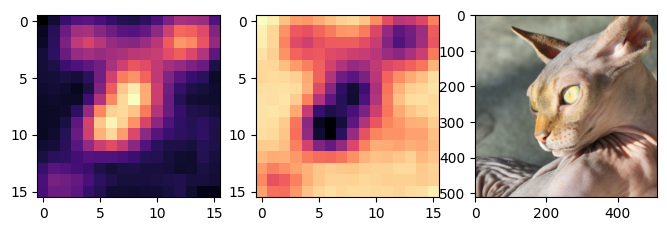

In [169]:
WHY = torch.einsum('ocij,kc -> okij', net1(x), l.weight.data)   # linear
fig,ax = plt.subplots(1,3,figsize=(8,4))
ax[0].imshow(WHY.to("cpu")[0,0].data,cmap='magma')  # 노랗게 물들인 부분(확신하는 부분)의 수치가 컸고, 이 값이 컸기때문에 최종 ap 와 fl에도 영향을 끼쳤음.
ax[1].imshow(WHY.to("cpu")[0,1].data,cmap='magma')
ax[2].imshow(torch.einsum('ocij -> ijc', x_dec),cmap='magma')


AP , Flatten , Linear 순서로 된 net2 를 linear, Ap, Flatten 순서로 바꿔보고싶다. 
- AP , Flatten , Linear 순서로 하나, linear, Ap, Flatten 순서로 하나 결과값은 똑같다.

**net2의 순서를 바꾼후 전체 네트워크**
$$\underset{(1,3,224,224)}{\boldsymbol x} \overset{net_1}{\to} \left( \underset{(1,512,16,16)}{\tilde{\boldsymbol x}} \overset{linear}{\to} \underset{(1,2,16,16)}{{\bf WHY}}\overset{ap}{\to} \underset{(1,2,1,1)}{{\boldsymbol \sharp}}\overset{flatten}{\to} \underset{(1,2)}{\hat{\boldsymbol y}}\right) = [[2.7846,-2.7945]]$$

- 참고: 여기에서 linear는 (1,512,16,16)의 each pixel에 `torch.nn.Linear(512,2)`를 수행함.

### $\star$ 잠깐 멈추고 생각 좀 해보자..
- net2의 순서를 바꿔도 똑같은건 알겠다.. 근데 왜 이 작업을 했느냐..?

`-` 입력이미지 

In [184]:
x.shape

torch.Size([1, 3, 512, 512])

In [185]:
x_pil, x

(PILImage mode=RGB size=500x333,
 TensorImage([[[[ 0.8104,  0.7933,  0.7762,  ..., -0.6794, -0.6794, -0.6794],
                [ 0.8104,  0.7933,  0.7762,  ..., -0.6965, -0.6965, -0.6965],
                [ 0.8104,  0.7933,  0.7762,  ..., -0.7137, -0.7137, -0.7137],
                ...,
                [-0.6623, -0.2171,  0.3138,  ...,  0.5707,  0.5364,  0.5022],
                [-0.7650, -0.3541,  0.1597,  ...,  0.5707,  0.5193,  0.4851],
                [-0.8335, -0.4568,  0.0398,  ...,  0.5707,  0.5193,  0.4679]],
 
               [[ 0.9930,  0.9755,  0.9580,  ..., -0.5301, -0.5126, -0.4951],
                [ 0.9930,  0.9755,  0.9580,  ..., -0.5301, -0.5126, -0.4951],
                [ 1.0105,  0.9930,  0.9580,  ..., -0.5126, -0.4951, -0.4951],
                ...,
                [-1.0553, -0.5301,  0.1527,  ..., -0.0399,  0.0126,  0.0476],
                [-1.1604, -0.6527,  0.0301,  ...,  0.0301,  0.0651,  0.0651],
                [-1.2479, -0.7402, -0.0574,  ...,  0.0826,  0.08

`-` 원래 net2를 그대로 적용한 결과를 해석 

In [186]:
net2    # ap, flatten ,Linear

Sequential(
  (0): AdaptiveAvgPool2d(output_size=1)
  (1): Flatten(start_dim=1, end_dim=-1)
  (2): Linear(in_features=512, out_features=2, bias=False)
)

In [187]:
net2(net1(x))

TensorImage([[ 3.8664, -5.1304]], device='cuda:0', grad_fn=<AliasBackward0>)

- "2.7846 > -2.7945" 이므로, `ximg`는 높은 확률로 고양이라는 것을 의미함. 

AP , Flatten , Linear 순서로 된 net2 를 linear, Ap, Flatten 순서로 바꿔보고싶다. 
- AP , Flatten , Linear 순서로 하나, linear, Ap, Flatten 순서로 하나 결과값은 똑같다.   (AP는 항상 Flatten보다 앞서 계산되어야 한다.)

`-` 바뀐 net2를 적용해볼까? 

In [193]:
#WHY = torch.einsum('ocij,kc -> okij', net1(x), l.weight.data)   # linear 

print(f"{x.shape} -- x")
print(f"{net1(x).shape} -- net1(x)")
print("=======================================")
print(f"{WHY.shape} -- l(net1(x)):=WHY")                        # linear

WHY.shape # WHY 는 net1 의 출력에 linear 변환을 한 결과를 의미

torch.Size([1, 3, 512, 512]) -- x
torch.Size([1, 512, 16, 16]) -- net1(x)
torch.Size([1, 2, 16, 16]) -- l(net1(x)):=WHY


torch.Size([1, 2, 16, 16])

In [199]:
# 계산방법 2
flatten(ap(WHY))        # linear , ap , flatten

TensorImage([[ 3.8664, -5.1304]], device='cuda:0', grad_fn=<AliasBackward0>)

In [200]:
WHY[0,0,:,:].shape

torch.Size([16, 16])

In [204]:
ap(WHY) , ap(WHY).shape

(TensorImage([[[[ 3.8664]],
 
               [[-5.1304]]]], device='cuda:0', grad_fn=<AliasBackward0>),
 torch.Size([1, 2, 1, 1]))

In [205]:
WHY[0,0,:,:].mean() # 이 값이 클수록 고양이

TensorImage(3.8664, device='cuda:0', grad_fn=<AliasBackward0>)

In [206]:
WHY[0,1,:,:].mean() # 이 값이 클수록 강아지 

TensorImage(-5.1304, device='cuda:0', grad_fn=<AliasBackward0>)

`-` 좀더 파고들어서 분석해보자. 

In [207]:
WHY[0,0,:,:].int() # 이 값들의 평균이 2.7846임. 그리고 이 평균값이 클수록 고양이

TensorImage([[-3, -1,  0,  2,  2,  1,  0,  0,  0,  0,  2,  4,  7,  7,  6,  2],
             [-2,  0,  4,  7,  7,  5,  4,  2,  2,  3,  5,  9, 13, 12, 10,  5],
             [-2,  0,  5,  9, 10,  8,  6,  5,  5,  6,  8, 12, 15, 14, 11,  6],
             [-1,  0,  3,  6,  7,  6,  7,  7,  8,  9,  9, 11, 12, 10,  8,  3],
             [-1,  0,  1,  2,  3,  4,  7,  9, 11, 11,  9,  7,  6,  5,  3,  0],
             [-1, -1,  0, -1,  0,  4, 10, 14, 15, 12,  8,  5,  2,  0,  0, -1],
             [-1, -1, -1, -2,  0,  5, 12, 17, 19, 16,  9,  4,  0,  0, -1, -1],
             [-2, -1, -1, -1,  1,  8, 14, 18, 20, 16,  9,  3,  0, -1, -1, -1],
             [-2, -2, -1,  0,  6, 14, 18, 18, 17, 13,  8,  3,  0,  0,  0, -1],
             [-2, -1,  0,  3, 10, 17, 20, 18, 15, 10,  5,  2,  0,  0,  0,  0],
             [-2, -1,  0,  3,  9, 16, 18, 15, 10,  6,  2,  1,  0,  0,  0,  0],
             [-1, -1,  0,  3,  6,  9, 11,  9,  5,  2,  0,  0,  0, -1,  0,  0],
             [ 0,  0,  0,  1,  2,  2,  2,  1,  1,  0

- 이 값들의 평균은 2.7846임. 
- 이 값들이 클수록 이 그림은 고양이라는 의미임 = 이 값이 작을수록 이 그림은 고양이 그림이 아니라는 의미임. 
- 그런데 살펴보니 **대부분의 위치에서 0에 가까운 값**을 가지고, **특정 위치에서만 엄청 큰 값**이 있어서 2.7846이라는 값이 나온 것임. 
- 특정위치에 존재하는 엄청 큰 값들은, `x`가 고양이 이미지라고 판단하는 근거가 된다. 

In [208]:
WHY[0,1,:,:].int() # 이 값들의 평균이 -2.7945임. 그리고 이 평균값이 클수록 강아지.  WHY 행렬이 곧이어 ap로 들어가는데, WHY의 특정 부분에 큰 값이 있다면 당연히 ap의 평균치에도 영향을 끼치고, 이는 classification의 최종 확률을 평가하는데도 사용되어, AI의 판단근거를 제시해준다.

TensorImage([[  3,   2,   0,  -2,  -2,  -1,   0,   0,   1,   0,  -3,  -7, -11,
              -10,  -8,  -4],
             [  2,   0,  -3,  -6,  -7,  -6,  -4,  -3,  -2,  -4,  -8, -13, -17,
              -16, -13,  -6],
             [  2,   1,  -4,  -8,  -9,  -7,  -6,  -6,  -6,  -7, -10, -14, -18,
              -16, -12,  -7],
             [  1,   0,  -3,  -6,  -7,  -6,  -8,  -8,  -9,  -9, -10, -13, -14,
              -12,  -9,  -4],
             [  1,   1,   0,  -2,  -4,  -6,  -9, -11, -13, -12, -10,  -8,  -7,
               -6,  -5,  -1],
             [  0,   1,   1,   0,  -1,  -6, -11, -16, -17, -15, -10,  -6,  -3,
               -1,   0,   1],
             [  1,   1,   1,   1,  -1,  -8, -14, -20, -23, -19, -12,  -5,  -1,
                0,   1,   1],
             [  1,   1,   1,   0,  -4, -11, -17, -21, -23, -18, -11,  -4,   0,
                1,   1,   1],
             [  1,   1,   1,  -1, -10, -20, -22, -21, -19, -15,  -9,  -4,  -1,
                0,   0,   1],
             [  1, 

- 이 값들의 평균은 -2.7945임. 
- 이 값들이 클수록 이 그림은 강아지라는 의미임 = 이 값이 작을수록 이 그림은 강아지가 아니라는 의미임. 
- 그런데 살펴보니 **대부분의 위치에서 0에 가까운 값**을 가지고, **특정 위치에서만 엄청 큰 작은값**이 있어서 -2.7945라는 값이 나온 것임. 
- 특정위치에 존재하는 엄청 큰 작은값들은, `x`가 강아지 이미지가 아니라고 판단하는 근거가 된다. 

$$\underset{(1,2,16,16)}{{\bf WHY}}\overset{ap}{\to} \underset{(1,2,1,1)}{{\boldsymbol \sharp}}\overset{flatten}{\to} \underset{(1,2)}{\hat{\boldsymbol y}} = [[2.7846,-2.7945]]$$

`-` 시각화1 

In [209]:
WHYCAT = WHY[0,0,:,:].to("cpu").detach()
WHYDOG = WHY[0,1,:,:].to("cpu").detach()

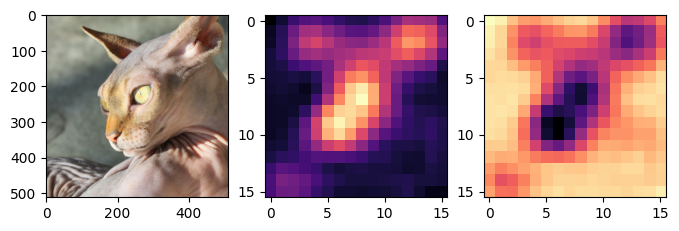

In [211]:
fig,ax = plt.subplots(1,3,figsize=(8,4))
ax[0].imshow(torch.einsum('ocij -> ijc',x_dec))
ax[1].imshow(WHYCAT,cmap='magma')
ax[2].imshow(WHYDOG,cmap='magma')

- magma: 검은색 < 보라색 < 빨간색 < 노란색 
- 가운데 그림의 노란부분은 고양이라는 증거, 오른쪽 그림의 검보라색 부분은 강아지가 아니라는 증거

`-` 시각화2

In [212]:
WHYCAT.shape

torch.Size([16, 16])

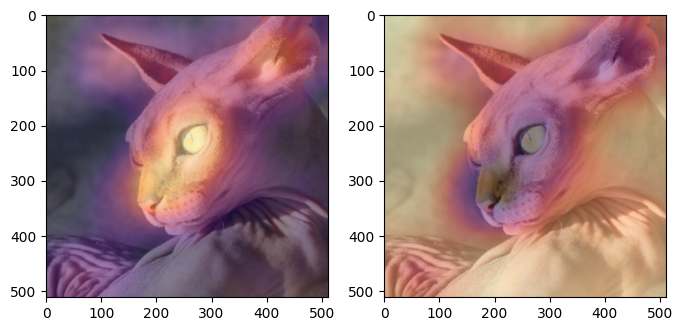

In [213]:
fig,ax = plt.subplots(1,2,figsize=(8,4))
ax[0].imshow(torch.einsum('ocij -> ijc',x_dec))
ax[0].imshow(WHYCAT,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
ax[1].imshow(torch.einsum('ocij -> ijc',x_dec))
ax[1].imshow(WHYDOG,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)

`-` 하니를 활용한 시각화 

In [214]:
x_pil = fastai.vision.core.PILImage.create(requests.get('https://github.com/guebin/DL2024/blob/main/imgs/01wk-hani1.jpeg?raw=true').content)
x = next(iter(dls.test_dl([x_pil])))[0] # lrnr를 학습이후에는 여기에 저장되는 x값이 조금 달라지게됨
x_dec = dls.decode([x])
WHY = torch.einsum('ocij,kc -> okij', net1(x), l.weight.data)
WHYCAT = WHY[0,0,:,:].to("cpu").detach()
WHYDOG = WHY[0,1,:,:].to("cpu").detach()
softmax = torch.nn.Softmax(dim=1)
cat_prob, dog_prob = softmax(flatten(ap(WHY))).to("cpu").detach().tolist()[0]

Text(0.5, 1.0, 'dog prob = 0.999381')

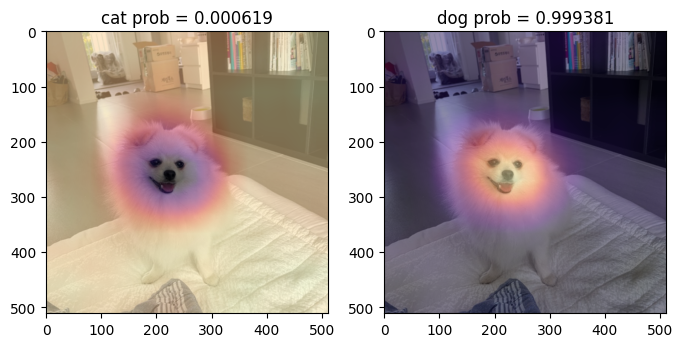

In [215]:
fig,ax = plt.subplots(1,2,figsize=(8,4))
ax[0].imshow(torch.einsum('ocij -> ijc',x_dec))
ax[0].imshow(WHYCAT,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
ax[0].set_title(f"cat prob = {cat_prob:.6f}")
ax[1].imshow(torch.einsum('ocij -> ijc',x_dec))
ax[1].imshow(WHYDOG,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
ax[1].set_title(f"dog prob = {dog_prob:.6f}")

In [225]:
x_pil = fastai.vision.core.PILImage.create(requests.get('https://image.kmib.co.kr/online_image/2020/1122/611718110015239102_4.jpg').content)
x = next(iter(dls.test_dl([x_pil])))[0] # lrnr를 학습이후에는 여기에 저장되는 x값이 조금 달라지게됨
x_dec = dls.decode([x])
WHY = torch.einsum('ocij,kc -> okij', net1(x), l.weight.data)
WHYCAT = WHY[0,0,:,:].to("cpu").detach()
WHYDOG = WHY[0,1,:,:].to("cpu").detach()
softmax = torch.nn.Softmax(dim=1)
cat_prob, dog_prob = softmax(flatten(ap(WHY))).to("cpu").detach().tolist()[0]

Text(0.5, 1.0, 'dog prob = 0.580398')

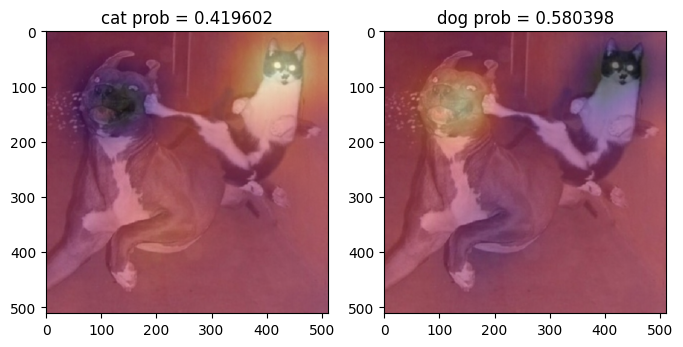

In [231]:
fig,ax = plt.subplots(1,2,figsize=(8,4))
ax[0].imshow(torch.einsum('ocij -> ijc',x_dec))
ax[0].imshow(WHYCAT,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
ax[0].set_title(f"cat prob = {cat_prob:.6f}")
ax[1].imshow(torch.einsum('ocij -> ijc',x_dec))
ax[1].imshow(WHYDOG,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
ax[1].set_title(f"dog prob = {dog_prob:.6f}")

Text(0.5, 1.0, 'dog prob = 0.995161')

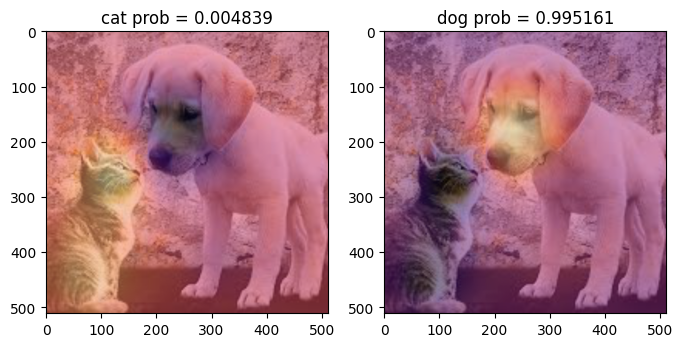

In [235]:
x_pil = fastai.vision.core.PILImage.create(requests.get('https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcT2whJUyCagyvwmQDT-hy-N_P9kuBIeZrwR8A&s').content)
x = next(iter(dls.test_dl([x_pil])))[0] # lrnr를 학습이후에는 여기에 저장되는 x값이 조금 달라지게됨
x_dec = dls.decode([x])
WHY = torch.einsum('ocij,kc -> okij', net1(x), l.weight.data)
WHYCAT = WHY[0,0,:,:].to("cpu").detach()
WHYDOG = WHY[0,1,:,:].to("cpu").detach()
softmax = torch.nn.Softmax(dim=1)
cat_prob, dog_prob = softmax(flatten(ap(WHY))).to("cpu").detach().tolist()[0]
fig,ax = plt.subplots(1,2,figsize=(8,4))
ax[0].imshow(torch.einsum('ocij -> ijc',x_dec))
ax[0].imshow(WHYCAT,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
ax[0].set_title(f"cat prob = {cat_prob:.6f}")
ax[1].imshow(torch.einsum('ocij -> ijc',x_dec))
ax[1].imshow(WHYDOG,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
ax[1].set_title(f"dog prob = {dog_prob:.6f}")

Text(0.5, 1.0, 'dog prob = 0.933646')

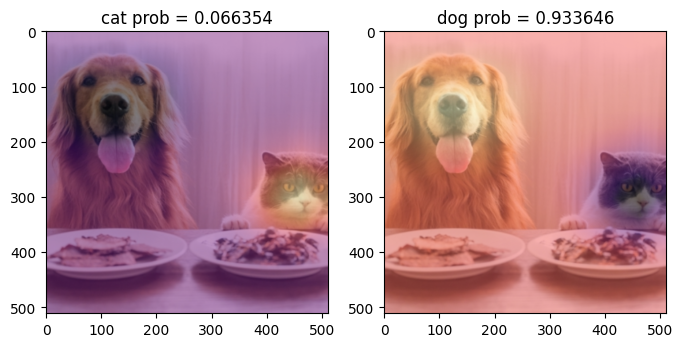

In [236]:
x_pil = fastai.vision.core.PILImage.create(requests.get('https://cdn.salgoonews.com/news/photo/202201/15410_38444_1522.jpg').content)
x = next(iter(dls.test_dl([x_pil])))[0] # lrnr를 학습이후에는 여기에 저장되는 x값이 조금 달라지게됨
x_dec = dls.decode([x])
WHY = torch.einsum('ocij,kc -> okij', net1(x), l.weight.data)
WHYCAT = WHY[0,0,:,:].to("cpu").detach()
WHYDOG = WHY[0,1,:,:].to("cpu").detach()
softmax = torch.nn.Softmax(dim=1)
cat_prob, dog_prob = softmax(flatten(ap(WHY))).to("cpu").detach().tolist()[0]
fig,ax = plt.subplots(1,2,figsize=(8,4))
ax[0].imshow(torch.einsum('ocij -> ijc',x_dec))
ax[0].imshow(WHYCAT,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
ax[0].set_title(f"cat prob = {cat_prob:.6f}")
ax[1].imshow(torch.einsum('ocij -> ijc',x_dec))
ax[1].imshow(WHYDOG,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
ax[1].set_title(f"dog prob = {dog_prob:.6f}")

## D. 4단계 -- CAM 시각화 

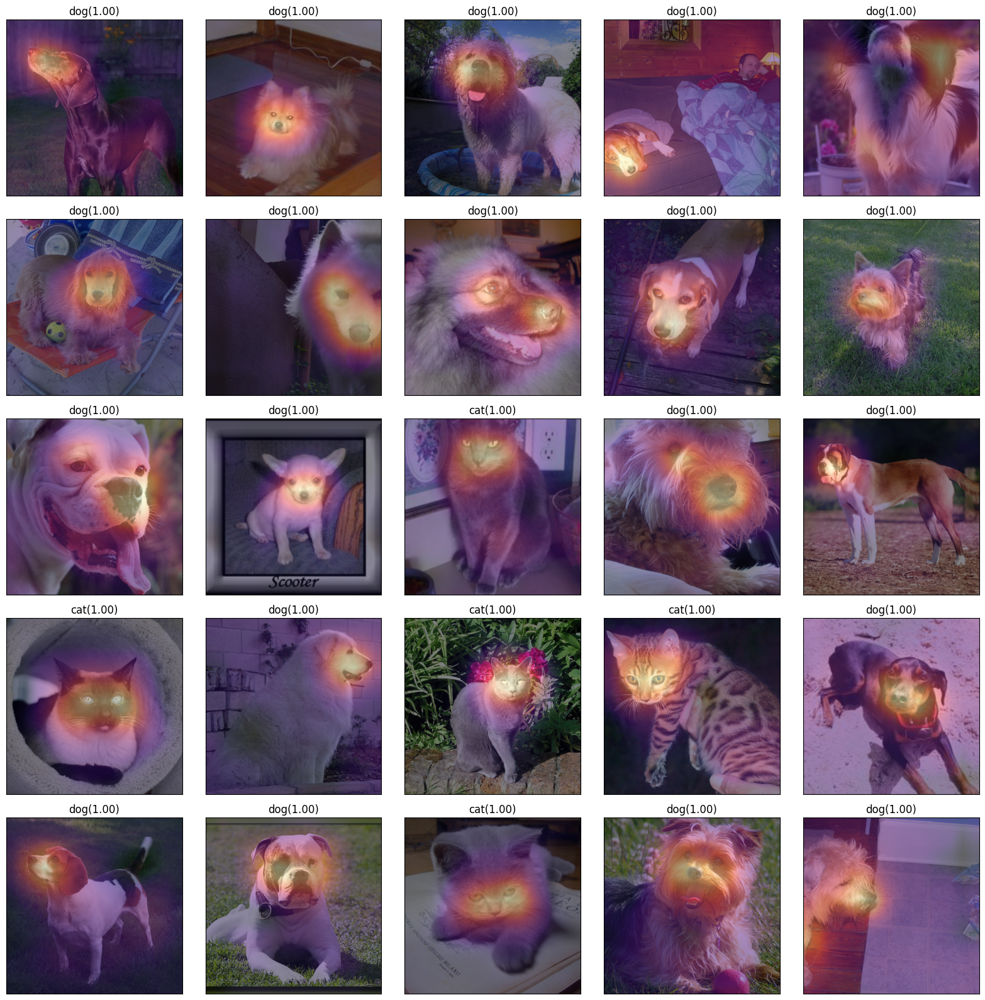

In [218]:
fig,ax = plt.subplots(5,5)
#---#
k=0
for i in range(5):
    for j in range(5):
        x_pil = fastai.vision.core.PILImage.create(fastai.data.transforms.get_image_files(path/'images')[k])
        x = next(iter(dls.test_dl([x_pil])))[0] # 이걸로 WHY를 만들어보자. 
        x_dec = dls.decode([x])[0] # 이걸로 시각화 
        WHY = torch.einsum('ocij,kc -> okij',net1(x),l.weight.data)
        WHYCAT = WHY[0,0,:,:].to("cpu").detach()
        WHYDOG = WHY[0,1,:,:].to("cpu").detach()
        cat_prob, dog_prob = softmax(flatten(ap(WHY))).to("cpu").detach().tolist()[0]
        if cat_prob > dog_prob: 
            ax[i][j].imshow(torch.einsum('ocij -> ijc',x_dec))
            ax[i][j].imshow(WHYCAT,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
            ax[i][j].set_title(f"cat({cat_prob:.2f})")
            ax[i][j].set_xticks([])
            ax[i][j].set_yticks([])            
        else: 
            ax[i][j].imshow(torch.einsum('ocij -> ijc',x_dec))
            ax[i][j].imshow(WHYDOG,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
            ax[i][j].set_title(f"dog({dog_prob:.2f})")
            ax[i][j].set_xticks([])
            ax[i][j].set_yticks([])            
        k=k+1
fig.set_figheight(16)
fig.set_figwidth(16)
fig.tight_layout()

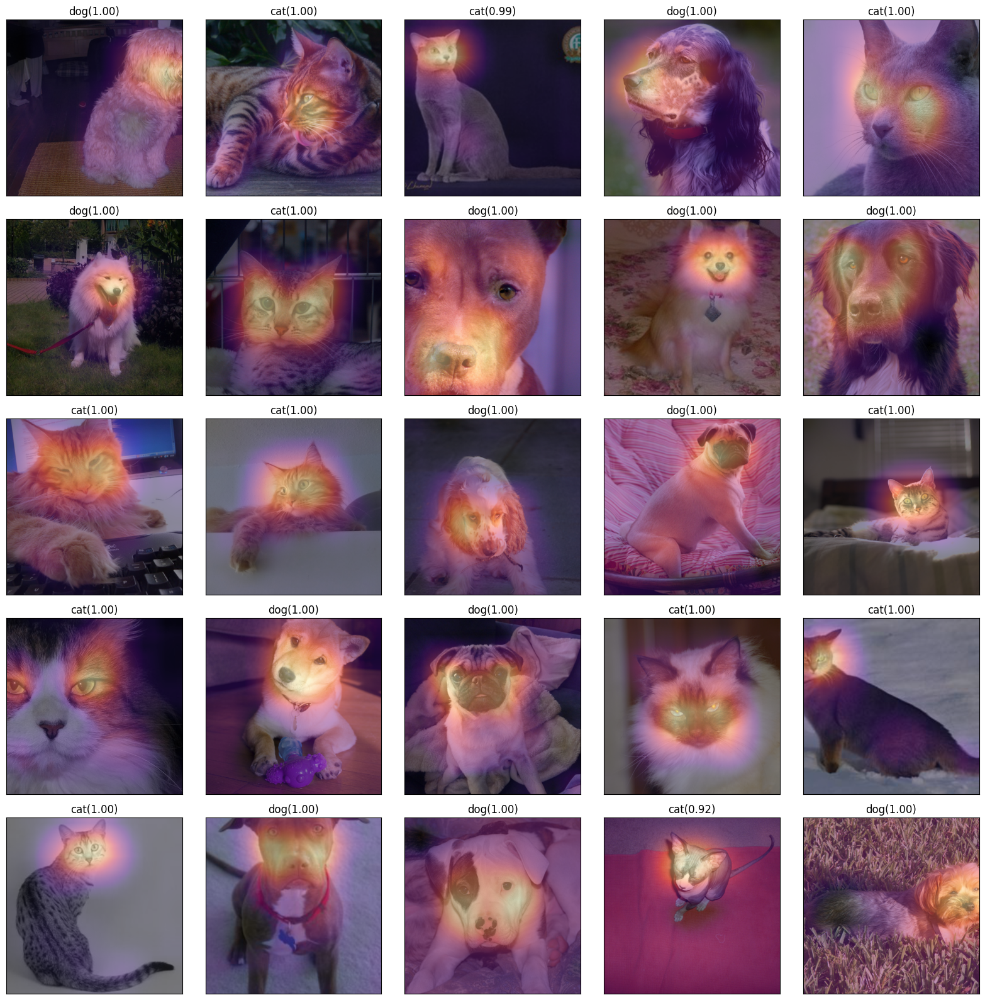

In [219]:
fig,ax = plt.subplots(5,5)
#---#
k=25
for i in range(5):
    for j in range(5):
        x_pil = fastai.vision.core.PILImage.create(fastai.data.transforms.get_image_files(path/'images')[k])
        x = next(iter(dls.test_dl([x_pil])))[0] # 이걸로 WHY를 만들어보자. 
        x_dec = dls.decode([x])[0] # 이걸로 시각화 
        WHY = torch.einsum('ocij,kc -> okij',net1(x),l.weight.data)
        WHYCAT = WHY[0,0,:,:].to("cpu").detach()
        WHYDOG = WHY[0,1,:,:].to("cpu").detach()
        cat_prob, dog_prob = softmax(flatten(ap(WHY))).to("cpu").detach().tolist()[0]
        if cat_prob > dog_prob: 
            ax[i][j].imshow(torch.einsum('ocij -> ijc',x_dec))
            ax[i][j].imshow(WHYCAT,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
            ax[i][j].set_title(f"cat({cat_prob:.2f})")
            ax[i][j].set_xticks([])
            ax[i][j].set_yticks([])
        else: 
            ax[i][j].imshow(torch.einsum('ocij -> ijc',x_dec))
            ax[i][j].imshow(WHYDOG,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
            ax[i][j].set_title(f"dog({dog_prob:.2f})")
            ax[i][j].set_xticks([])
            ax[i][j].set_yticks([])            
        k=k+1
fig.set_figheight(16)
fig.set_figwidth(16)
fig.tight_layout() 

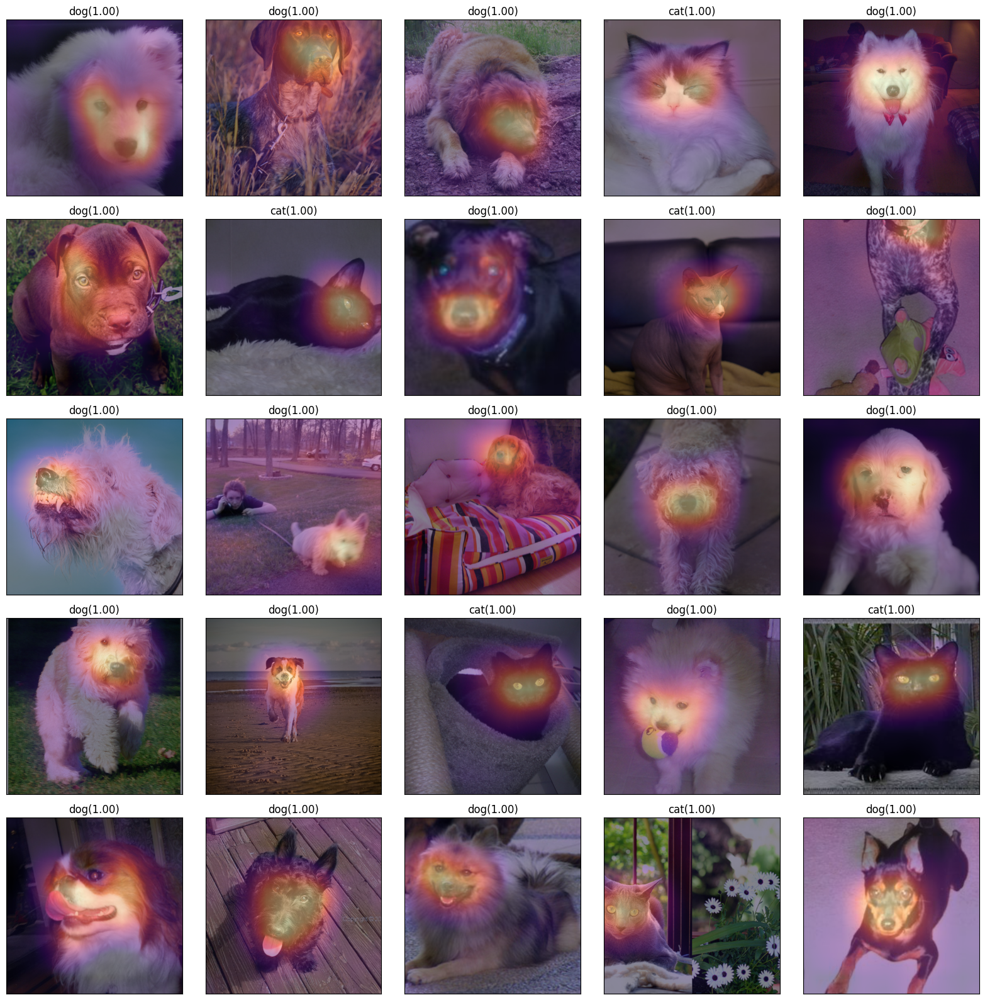

In [220]:
fig,ax = plt.subplots(5,5)
#---#
k=50
for i in range(5):
    for j in range(5):
        x_pil = fastai.vision.core.PILImage.create(fastai.data.transforms.get_image_files(path/'images')[k])
        x = next(iter(dls.test_dl([x_pil])))[0] # 이걸로 WHY를 만들어보자. 
        x_dec = dls.decode([x])[0] # 이걸로 시각화 
        WHY = torch.einsum('ocij,kc -> okij',net1(x),l.weight.data)
        WHYCAT = WHY[0,0,:,:].to("cpu").detach()
        WHYDOG = WHY[0,1,:,:].to("cpu").detach()
        cat_prob, dog_prob = softmax(flatten(ap(WHY))).to("cpu").detach().tolist()[0]
        if cat_prob > dog_prob: 
            ax[i][j].imshow(torch.einsum('ocij -> ijc',x_dec))
            ax[i][j].imshow(WHYCAT,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
            ax[i][j].set_title(f"cat({cat_prob:.2f})")
            ax[i][j].set_xticks([])
            ax[i][j].set_yticks([])            
        else: 
            ax[i][j].imshow(torch.einsum('ocij -> ijc',x_dec))
            ax[i][j].imshow(WHYDOG,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
            ax[i][j].set_title(f"dog({dog_prob:.2f})")
            ax[i][j].set_xticks([])
            ax[i][j].set_yticks([])            
        k=k+1
fig.set_figheight(16)
fig.set_figwidth(16)
fig.tight_layout()

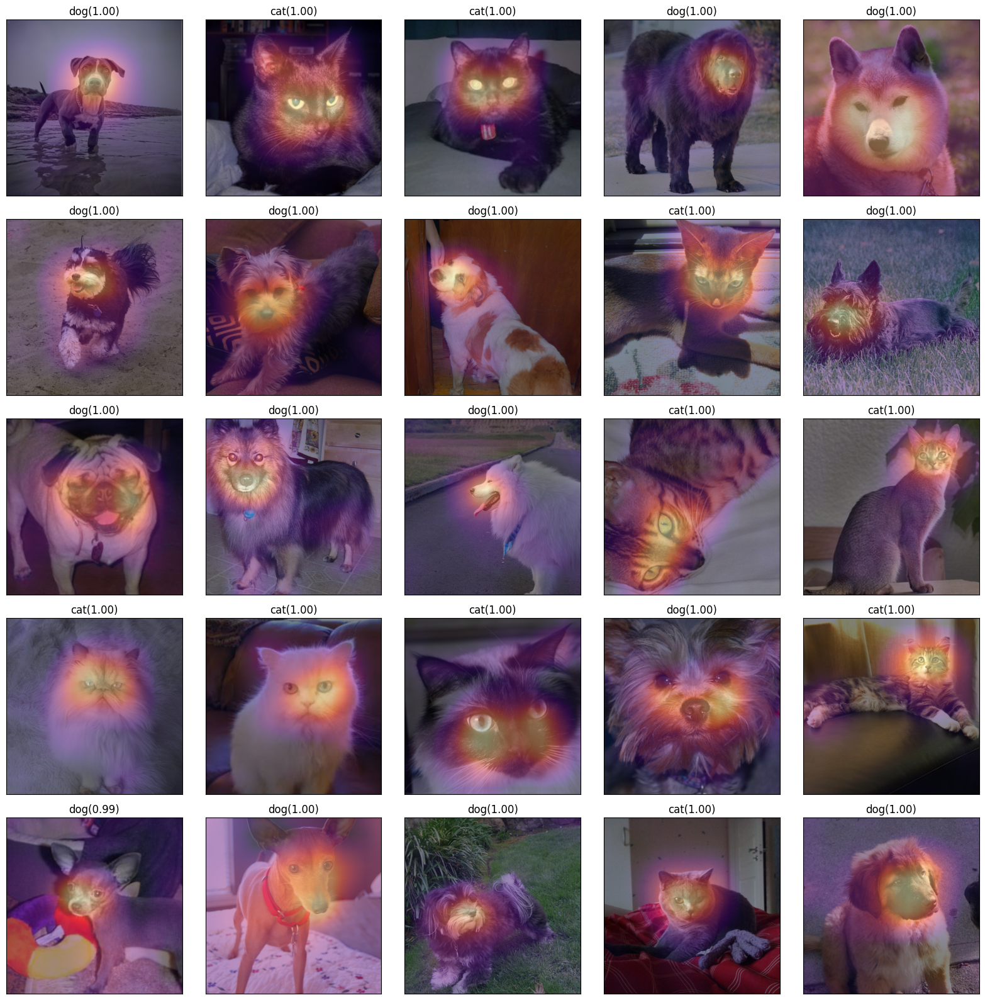

In [221]:
fig,ax = plt.subplots(5,5)
#---#
k=75
for i in range(5):
    for j in range(5):
        x_pil = fastai.vision.core.PILImage.create(fastai.data.transforms.get_image_files(path/'images')[k])
        x = next(iter(dls.test_dl([x_pil])))[0] # 이걸로 WHY를 만들어보자. 
        x_dec = dls.decode([x])[0] # 이걸로 시각화 
        WHY = torch.einsum('ocij,kc -> okij',net1(x),l.weight.data)
        WHYCAT = WHY[0,0,:,:].to("cpu").detach()
        WHYDOG = WHY[0,1,:,:].to("cpu").detach()
        cat_prob, dog_prob = softmax(flatten(ap(WHY))).to("cpu").detach().tolist()[0]
        if cat_prob > dog_prob: 
            ax[i][j].imshow(torch.einsum('ocij -> ijc',x_dec))
            ax[i][j].imshow(WHYCAT,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
            ax[i][j].set_title(f"cat({cat_prob:.2f})")
            ax[i][j].set_xticks([])
            ax[i][j].set_yticks([])            
        else: 
            ax[i][j].imshow(torch.einsum('ocij -> ijc',x_dec))
            ax[i][j].imshow(WHYDOG,cmap='magma',extent = (0,511,511,0), interpolation='bilinear',alpha=0.5)
            ax[i][j].set_title(f"dog({dog_prob:.2f})")
            ax[i][j].set_xticks([])
            ax[i][j].set_yticks([])            
        k=k+1
fig.set_figheight(16)
fig.set_figwidth(16)
fig.tight_layout()